In [2]:
import io
import base64
from IPython.display import HTML
import numpy as np

filename = 'C:/Users/amirp/Pictures/Camera Roll/test.mp4'

In [3]:
video = io.open(filename, 'r+b').read()
encoded = base64.b64encode(video)
HTML(data='''<video alt="test" controls>
                <source src="data:video/mp4;base64,{0}" type="video/mp4" />
             </video>'''.format(encoded.decode('ascii')))

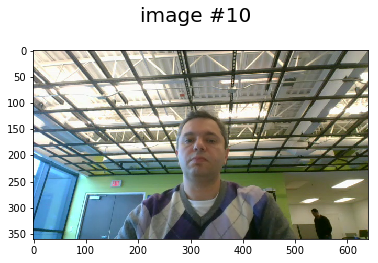

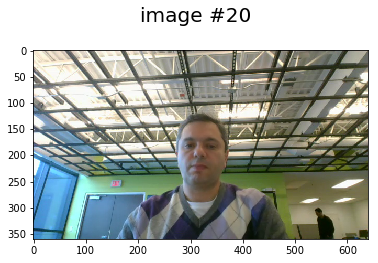

In [4]:
import pylab
import imageio

vid = imageio.get_reader(filename,  'ffmpeg')
nums = [10, 20]
for num in nums:
    image = vid.get_data(num)
    fig = pylab.figure()
    fig.suptitle('image #{}'.format(num), fontsize=20)
    pylab.imshow(image)
pylab.show()
vid.close()

In [7]:
def rgb2gray(rgb):
    return np.dot(rgb[...,:3], [0.299, 0.587, 0.114])

vid = imageio.get_reader(filename,  'ffmpeg')

fps = vid.get_meta_data()['fps']

image1 = rgb2gray(vid.get_data(0))

for i in [100]: #vid.get_length()):
    image2 = rgb2gray(vid.get_data(i + 1))
    image_dif = image2 - image1

vid.close()

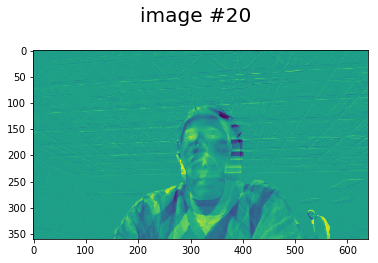

In [6]:
fig = pylab.figure()
fig.suptitle('image #{}'.format(num), fontsize=20)
pylab.imshow(image_dif)
pylab.show()

In [8]:
vid = imageio.get_reader(filename,  'ffmpeg')
fps = vid.get_meta_data()['fps']

image_dif = []

image1 = rgb2gray(vid.get_data(0))

for i in np.arange(vid.get_length() - 1):
    image2 = rgb2gray(vid.get_data(i + 1))
    image_dif.append(image2 - image1)
    image1 = image2

vid.close()

In [14]:
writer = imageio.get_writer('C:/Users/amirp/Pictures/Camera Roll/dif.mp4', fps=fps)

for i in np.arange(len(image_dif)):
    img = image_dif[i] + 128
    writer.append_data(img.astype(np.uint8))

writer.close()